# Hive Simulation

In [2]:
import numpy as np
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
# Configure animation for jupyter notebook
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [3]:
# Class to represent the environment of the model
class Hive():
  def __init__(self, termites, density, size):
    self.n_termites = termites # Number of termites in the hive
    self.density = density # Density of wood in the hive
    self.size = size # Size of the grid that represents the hive
    self.grid = np.zeros((size, size)) # Grid to represent the hive
    self.termites = [] # List to store the termites in the hive
    self.step_n = 0 # Current step number for the simulation
    self.termites_wood_n = 0 # Number of termites carrying a  wood
    self.termites_n = 0 # Number of termites without wood
    self.colors = {
        'empty': 0, # Color code for empty cells in the grid
        'termite': 1, # Color code for cells occupied by termites
        'wood': 0.7, # Color code for cells with a wood on it
        'termite_wood': 0.6 # Color code for cells with termites carrrying a wood
    }
    self.create_termites() # Initialize the hhive with wood and termites on it

  # Returns a random position within the grid
  def random_position(self):
    return np.random.randint(0, self.size, 2)
  
  # Returns the value at a specific grid position
  def get_grid_value(self, position):
    return self.grid[position[0], position[1]]

  # Assign a color code to the position in the grid
  def set_grid_value(self, position, value):
    if value in self.colors:
      self.grid[position[0], position[1]] = self.colors[value]
    else:
      print("ERROR trying to assign incorrect color to grid")

  # Assign random woods in the grid given their density
  def create_woods(self):
    for i in range(int(self.density * self.size * self.size)):
      position = self.random_position()
      # Assign woods on cells where the is no other wood
      while (self.get_grid_value(position) == self.colors['wood'] or
              self.get_grid_value(position) == self.colors['termite_wood']):
        position = self.random_position()
      if self.get_grid_value(position) == self.colors['empty']:
        self.set_grid_value(position, 'wood')
      else:
        print("ERROR trying to assign wood to incorrect position")

  # Initialize woods and create termites
  def create_termites(self):
    self.create_woods()
    for i in range(self.n_termites):
      termite = Termite(i, self)
      self.termites.append(termite)

  # Excecutes a step of the simulation
  def step(self, i):
    if i > 0:
      # Increment step number
      self.step_n += 1
      # Suffle the order in which termites work
      np.random.shuffle(self.termites)
      for termite in self.termites:
        # Perform the step for each termite
        termite.step()

    # Display the grid
    axs.clear()
    axs.imshow(self.grid, cmap='hot', vmin=0, vmax=1, interpolation='nearest')
    
    # Customize the title
    title_text = f"Step #{self.step_n} \nTermites without wood: {self.termites_n} \nTermites carrying wood: {self.termites_wood_n}"
    title_fontsize = 11
    axs.set_title(title_text, fontsize=title_fontsize)
    axs.set_xticks([])
    axs.set_yticks([])


In [4]:
# Class to represent the termite as an agent of the hive model 
class Termite():
  def __init__(self, id, hive):
    self.id = id
    self.hive = hive
    # Initialize the termite in a hive position once its created
    self.move_termite('start')

  # Conditions for the movement of a termite
  def move_termite(self, value):
    # Find an empty position on the hive to move
    if value == 'empty':
      position = self.hive.random_position()
      while self.hive.get_grid_value(position) != self.hive.colors['empty']:
        position = self.hive.random_position()
      self.position = position
      self.update_hive()
    # Find an empty position on the hive and carry a wood
    elif value == 'empty_with_wood':
      position = self.hive.random_position()
      while self.hive.get_grid_value(position) != self.hive.colors['empty']:
        position = self.hive.random_position()
      self.position = position
      self.hive.set_grid_value(self.position, 'termite_wood')
    # Find where to start on the hive
    elif value == 'start':
      position = self.hive.random_position()
      # Position without other termite on it
      while (self.hive.get_grid_value(position) == 
             self.hive.colors['termite'] or
             self.hive.get_grid_value(position) == 
             self.hive.colors['termite_wood']):
        position = self.hive.random_position()
      self.position = position
      self.update_hive()

  # Get state of the termite if its carrying a wood or not
  def current_state(self):
    if (self.hive.get_grid_value(self.position) == 
        self.hive.colors['termite']):
      return 'termite'
    elif (self.hive.get_grid_value(self.position) == 
          self.hive.colors['termite_wood']):
      return 'termite_wood'
    else:
      print("Error Termite not in grid")

  # Set the termite on the hive with or without a wood
  def update_hive(self):
    if self.hive.get_grid_value(self.position) == self.hive.colors['empty']:
      self.hive.set_grid_value(self.position, 'termite')
      self.hive.termites_n += 1
    elif self.hive.get_grid_value(self.position) == self.hive.colors['wood']:
      self.hive.set_grid_value(self.position, 'termite_wood')
      self.hive.termites_wood_n += 1
    else:
      print("ERROR trying to assign termite to incorrect position")

  # Get number of woods around the termite
  def wood_neighbors(self):
    neighbors = []
    x_pos, y_pos = self.position
    offsets = [(dx, dy) for dx in range(-1, 2) for dy in range(-1, 2)]
    for x, y in offsets:
      nx, ny = x_pos + x, y_pos + y
      if 0 <= nx < self.hive.size and 0 <= ny < self.hive.size:
        if self.hive.get_grid_value([nx, ny]) == self.hive.colors['wood']:
          neighbors.append([nx, ny])
    return neighbors

  # Choose an action for every timeframe for the termite
  def step(self):
    # If termite isn't carrying a wood
    if self.current_state() == 'termite':
      # Look if termite has woods around
      wood_neighbors = self.wood_neighbors()
      # If termite has woods around pick one and leave the other one empty
      if len(wood_neighbors) > 0:
        rand_i = np.random.randint(0, len(wood_neighbors))
        neighbor = wood_neighbors[rand_i]
        self.hive.set_grid_value(neighbor, 'empty')
        self.hive.set_grid_value(self.position, 'termite_wood')
        self.hive.termites_n -= 1
        self.hive.termites_wood_n += 1
      # If termite doesn't have woods around
      elif len(wood_neighbors) == 0:
        # Move to empty space and leave current one empty
        self.hive.set_grid_value(self.position, 'empty')
        self.hive.termites_n -= 1
        self.move_termite('empty')
      else:
        print("Error getting Termite neighbors")
    # If termite is carrying a wood
    elif self.current_state() == 'termite_wood':
      # Leave the wood on the current cell if there are other woods around
      wood_neighbors = self.wood_neighbors()
      if len(wood_neighbors) > 0:
        self.hive.set_grid_value(self.position, 'wood')
        self.hive.termites_wood_n -= 1
        self.move_termite('empty')
      # If there are no woods around fly to a random empty cell on the hive
      elif len(wood_neighbors) == 0:
        self.hive.set_grid_value(self.position, 'empty')
        self.move_termite('empty_with_wood')



For the next simulation, termites are represented in white, termites carrying a wood in orange, woods in yellow and empty spaces in the hive in black.


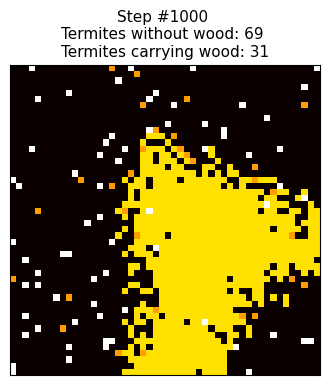

In [ ]:
# Set hive conditions
SEED = 15
TERMITES = 100
DENSITY = 0.3
COLONY_SIZE = 50
STEPS = 1000

# Set seed for random number generation
np.random.seed(SEED)
# Initialize hive
hive = Hive(TERMITES, DENSITY, COLONY_SIZE)
fig, axs = plt.subplots(figsize=(4, 5))

# Animate and simulate hive for a given number of steps
anim = animation.FuncAnimation(fig, hive.step, frames = STEPS + 1)
anim